# Aim
The aim is to test pytesseract on all image formats

Original, Binary, Gray


In [1]:
import cv2
import pytesseract
import numpy
import matplotlib.pyplot as plt
import glob

import math
from termcolor import colored

tess_config = "-c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789 --psm 6"


In [2]:
def get_image_formats(img):

    # Scales, calculates absolute values, and converts the result to 8-bit.
    plate_image = cv2.convertScaleAbs(img, alpha=(255.0))

    # convert to grayscale and blur the image
    gray = cv2.cvtColor(plate_image, cv2.COLOR_BGR2GRAY)
    #blur = cv2.GaussianBlur(gray,(7,7),0)

    # Applied inversed thresh_binary 
    binary = cv2.threshold(gray, 180, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
    binary_inverted = cv2.threshold(gray, 180, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    #kernel3 = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    #dilate = cv2.morphologyEx(binary, cv2.MORPH_DILATE, kernel3)
    
    return plate_image, gray, binary, binary_inverted #dilate

In [3]:
def image_OCR(img, image_format = 'binary'):
    plate_image, gray, binary, binary_inverted = get_image_formats(img)
    #plt.imshow(binary, cmap = "gray")
    if image_format == 'original':
        inimg = plate_image
    elif image_format =='gray':
        inimg = gray
    elif image_format=='binary':
        inimg = binary
    elif image_format=='binary_inverted':
        inimg = binary_inverted
        
    final_string = resized_image_string = pytesseract.image_to_string(inimg, config=tess_config, lang="eng")
    return final_string, inimg
        

In [4]:
def get_allsize_strings(test_image, image_format = 'binary'):
    maxw = 10
    maxh = 5

    sc = 64

    str_list = []

    #plt.figure(figsize = (30,30))
    imcnt = 1
    for resh in range(0,maxh):
        for resw in range(resh+1,maxw):

            #print(imcnt)
            ww = sc + (resw*sc)
            hh = sc + (resh*sc)
            resized_test_image = cv2.resize(test_image, (ww,hh),interpolation = cv2.INTER_AREA)
            resized_image_string, inimg= image_OCR(resized_test_image.astype(numpy.uint8)/255, image_format)
            titlestr = str(f'{ww}x{hh} : {resized_image_string}')
            str_list.append(resized_image_string)

            #print(f'Detected strings : {titlestr}')


            imcnt = imcnt + 1
            
    return str_list

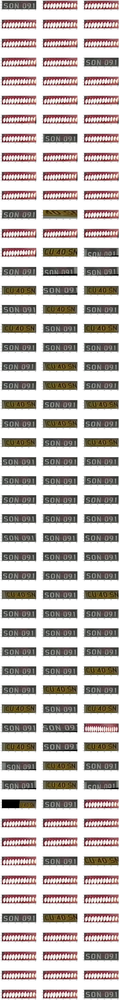

In [5]:
#img_folder_path = ('../plate_samples_110_470/*.jpg')
img_folder_path = ('../../TSK_00_MSC/wt2-body-tracker/output/Dash_cam_4/det_LpImg_crops/*.jpg')

fnames = glob.glob(img_folder_path)
fnames.sort()
#print(fnames)

cols = 3
rows = math.ceil(len(fnames)/cols)

plt.figure(figsize=(30,rows*5))
for fcnt, f in enumerate(fnames):
    img = plt.imread(f)
    plt.subplot(rows,cols,fcnt+1)    
    plt.imshow(img)
    #title = str(img.shape)
    #plt.title(title, fontsize=25 )

In [6]:
image_types = ['original','gray','binary','binary_inverted']

def test_all_formats(test_image):

    plt.figure(figsize=(30,10))
    
    for type_cnt, img_type in enumerate(image_types):
        test_image_string, inimg = image_OCR(test_image.astype(numpy.uint8)/255, img_type)   
        plt.subplot(1,len(image_types), type_cnt+1)
        plt.imshow(inimg, cmap = "gray")
        #print(colored(f'Original img pred string : {test_image_string}','red'))
        plt.title(test_image_string, fontsize = 20)
    
    plt.show() 
    

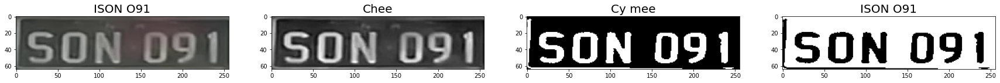

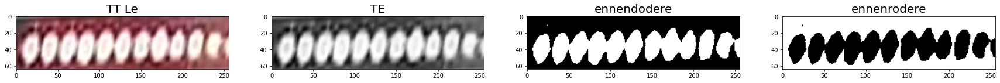

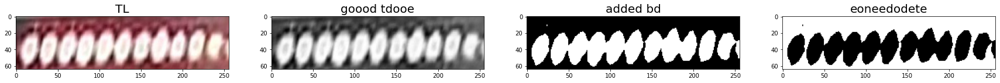

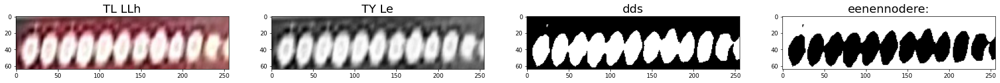

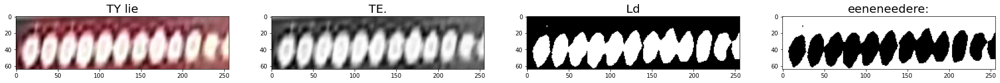

...

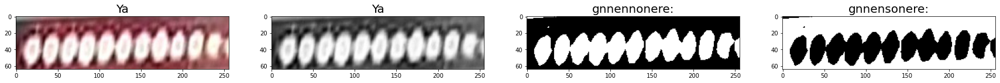

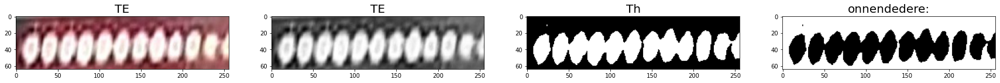

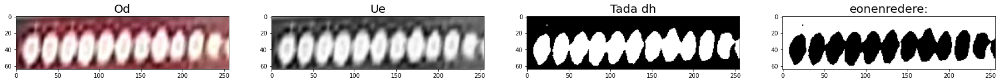

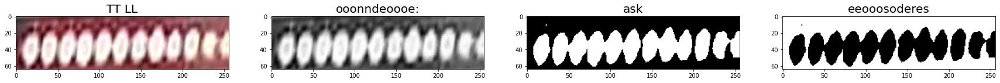

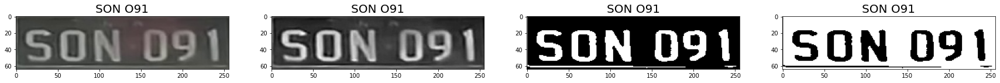

In [7]:
for img_path in fnames:
    test_image = plt.imread(img_path)
    test_all_formats(test_image)
    #print('********************************************************************************************')